## Creating a function that changes the resolution of any grid and then visualizes it.

In [1]:
import geopandas as gpd
from netCDF4 import Dataset
import matplotlib.pyplot as plt
import numpy as np
#import os

In [2]:
gdf = gpd.read_file(r'C:\Users\Ankit\Documents\Vedanshi\ML-hands-on\course_work\shp_rohit\alknanda.shp')
gdf = gdf.to_crs(4326)
gdf=gdf.to_crs(4326)

In [3]:
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

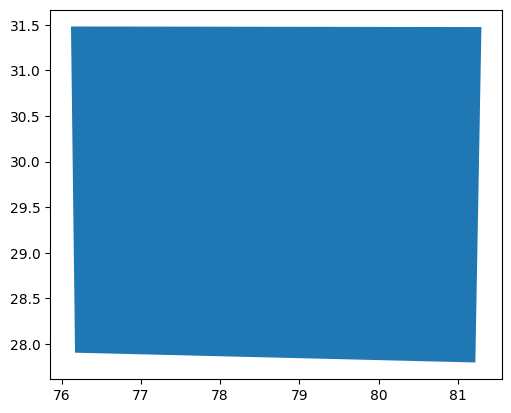

In [4]:
gdf.plot()

In [5]:
bound_box=gdf.total_bounds
minx,miny,maxx,maxy=bound_box

In [6]:
from shapely.geometry import box
# Create a rectangle from these coordinates using shapely's box function
rectangle = gpd.GeoSeries([box(minx, miny, maxx, maxy)], crs='epsg:4326')
# Print the rectangle coordinates
print(f"Bounding Box Coordinates: {bound_box}")
print(f"Rectangle Geometry: {rectangle}")

Bounding Box Coordinates: [76.11703155 27.79598912 81.29884383 31.48307196]
Rectangle Geometry: 0    POLYGON ((81.29884 27.79599, 81.29884 31.48307...
dtype: geometry


<Axes: >

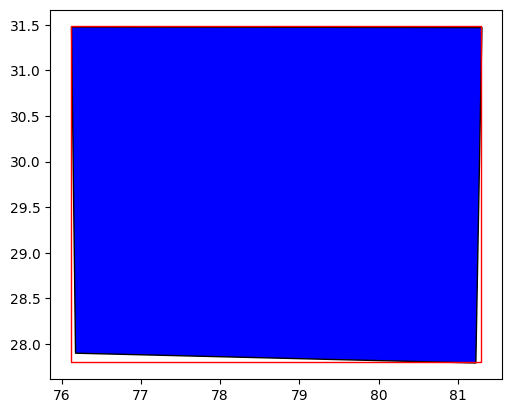

In [7]:
ax = gdf.plot(color='blue', edgecolor='k')
rectangle.plot(ax=ax, color='none', edgecolor='red')

In [8]:
polygon=gdf.geometry[0]
coordinates = list(polygon.exterior.coords)
coordinates.remove(coordinates[4])
coordinates

[(81.29884382960824, 31.476528380639817),
 (81.22216592787854, 27.795989119659698),
 (76.16815971828309, 27.903402904818343),
 (76.1170315460337, 31.483071960344766)]

In [9]:
#changing the parameters to improve the fit of the box.
minx=76.16815971828309
miny=27.803402904818343
maxx=81.24216592787854

Bounding Box Coordinates: [76.11703155 27.79598912 81.29884383 31.48307196]
Rectangle Geometry: 0    POLYGON ((81.24217 27.8034, 81.24217 31.48307,...
dtype: geometry


<Axes: >

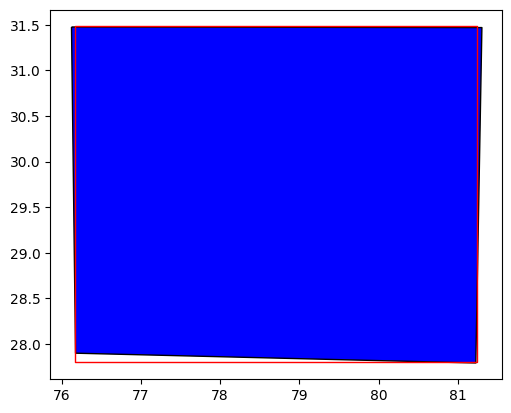

In [10]:
from shapely.geometry import box
# Create a rectangle from these coordinates using shapely's box function
rectangle = gpd.GeoSeries([box(minx, miny, maxx, maxy)], crs='epsg:4326')
# Print the rectangle coordinates
print(f"Bounding Box Coordinates: {bound_box}")
print(f"Rectangle Geometry: {rectangle}")
ax = gdf.plot(color='blue', edgecolor='k')
rectangle.plot(ax=ax, color='none', edgecolor='red')

In [11]:
# function to calculate grid parameters
def calculate_grid_parameters(coord):
    d = np.diff(coord)[0] / 2
    cell_boundaries = np.concatenate([[coord[0] - d], coord + d])
    return cell_boundaries

In [12]:
# function to create grid cell taking arguments from x_values and y_values
def initialize_and_populate_grid(x_values, y_values):
    ngrid_cell = len(x_values) * len(y_values)
    grid_cell = [{} for _ in range(ngrid_cell)]
    
    dy = y_values[1] - y_values[0]
    k = 0
    
    loncell = calculate_grid_parameters(x_values)
    latcell = calculate_grid_parameters(y_values)
    
    for i, lon in enumerate(x_values):
        for j, lat in enumerate(y_values):
            x_coords = [round(loncell[i], 2), round(loncell[i], 2), round(loncell[i+1], 2), round(loncell[i+1], 2), round(loncell[i], 2)]
            y_coords = [round(latcell[j], 2), round(latcell[j+1], 2), round(latcell[j+1], 2), round(latcell[j], 2), round(latcell[j], 2)] if dy > 0 else \
                       [round(latcell[j+1], 2), round(latcell[j], 2), round(latcell[j], 2), round(latcell[j+1], 2), round(latcell[j+1], 2)]
            
            grid_cell[k] = {'X':x_coords,'Y':y_coords,'Xc': round(lon, 2), 'Yc': round(lat, 2)}
            k += 1
    return grid_cell

In [13]:
def res_change(minx, miny, maxx, maxy, input_res, output_res):
    '''returns the x and y coordinates of centroids for the input and output resolution grid, in the order of 
    x,y being the x and y coordinates of the centroids of the grid cells for the input resolution grid and x_out,y_out being the x and y coordinates of the centroids of the grid cells for the output resolution grid.
    the function also returns the grid for output resolution.
    it also visualizes the grid for input and output resolution.'''
    
    if ((maxx-minx)*(maxy-miny)!=((input_res/output_res)**2)*(maxx-minx)*(maxy-miny)):
        print("The resolution change is not exact.")
        #back_calc((minx, miny, maxx, maxy))
        
    else:
        print("The resolution change is exact.")

    # Generate x-values for the input resolution grid
    x_values = []
    current_x = minx
    while current_x < maxx:
        x_values.append(current_x)
        current_x += input_res
    
    # Generate y-values for the input resolution grid
    y_values = []
    current_y = miny
    while current_y < maxy:
        y_values.append(current_y)
        current_y += input_res
    
    x_values = np.array(x_values, dtype=float)
    y_values = np.array(y_values, dtype=float)
    
    grid_cell = initialize_and_populate_grid(x_values, y_values)
    xc = [i['Xc'] for i in grid_cell]
    yc = [i['Yc'] for i in grid_cell]
    x, y = np.meshgrid(xc, yc)
    
    
    rectangle = gpd.GeoSeries([box(minx, miny, maxx, maxy)], crs='epsg:4326')
    fig, ax = plt.subplots()
    ax.scatter(x, y, s=1, color='blue')
    rectangle.plot(ax=ax, color='none', edgecolor='red')
    plt.title('Image for input resolution')
    plt.show()
    
    # Generate x-values for the output resolution grid
    x_values_output = []
    current_x_output = minx
    while current_x_output < maxx:
        x_values_output.append(current_x_output)
        current_x_output += output_res
    
    # Generate y-values for the output resolution grid
    y_values_output = []
    current_y_output = miny
    while current_y_output < maxy:
        y_values_output.append(current_y_output)
        current_y_output += output_res
    
    x_values_output = np.array(x_values_output, dtype=float)
    y_values_output = np.array(y_values_output, dtype=float)
    
    grid_cell_output = initialize_and_populate_grid(x_values_output, y_values_output)
    xc_output = [i['Xc'] for i in grid_cell_output]
    yc_output = [i['Yc'] for i in grid_cell_output]
    x_out, y_out = np.meshgrid(xc_output, yc_output)
    
    rectangle_out = gpd.GeoSeries([box(minx, miny, maxx, maxy)], crs='epsg:4326')
    fig_out, ax_out = plt.subplots()
    ax_out.scatter(x_out, y_out, s=1, color='black')
    rectangle_out.plot(ax=ax_out, color='none', edgecolor='red')
    plt.title('Image for output resolution')
    plt.show()
    print("lenghts of x_values,y_values,x_values_output,y_values_output: ",len(x_values), len(y_values), len(x_values_output), len(y_values_output))
    return x,y,x_out,y_out,grid_cell_output


In [14]:
minx=76.16815971828309
miny=27.803402904818343
maxx=81.24216592787854
maxy=31.400000000000002

## Reading the shape file and trying to fit it in the grid

In [15]:
#importing the required libraries
import geopandas as gpd 
import pandas as pd
import numpy as np
from shapely.geometry import Polygon

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

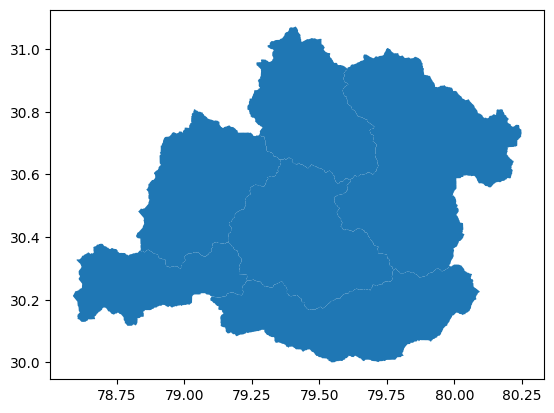

In [16]:
#reading and fitting the shapefile onto the created grid
pth=r'C:\Users\Ankit\Documents\Vedanshi\ML-hands-on\Shapefile_alakananda-20240627T070711Z-001\Shapefile_alakananda\alak_shape_all_84.shp'
shape_file = gpd.read_file(pth)
shape_file.plot()
shape_file.crs

In [17]:
bounding_box=shape_file.total_bounds
bounding_box

array([78.58733532, 30.00003852, 80.24941363, 31.07195327])

In [18]:
new_bounds=[minx,miny,maxx,maxy] #bounds of the box file.
new_bounds-bounding_box

array([-2.4191756 , -2.19663561,  0.9927523 ,  0.32804673])

In [19]:
#manully changing the bounding box to fit the shapefile with approximately +10km on evey side.
minx+=2.32
miny+=2.1034029
maxx-=0.9
maxy-=0.29
new_bounds=[minx,miny,maxx,maxy]
print(new_bounds-bounding_box)
new_bounds

[-0.0991756  -0.09323271  0.0927523   0.03804673]


[78.48815971828309, 29.90680580481834, 80.34216592787854, 31.110000000000003]

The resolution change is not exact.


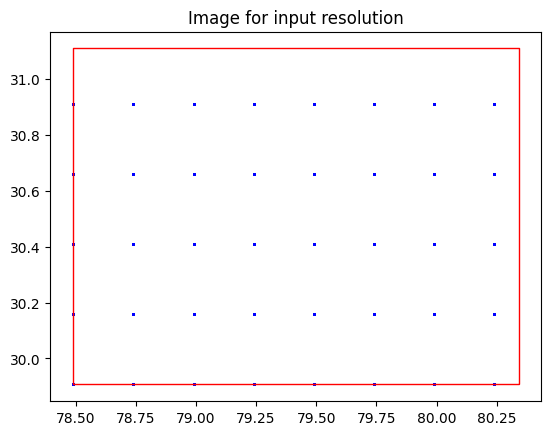

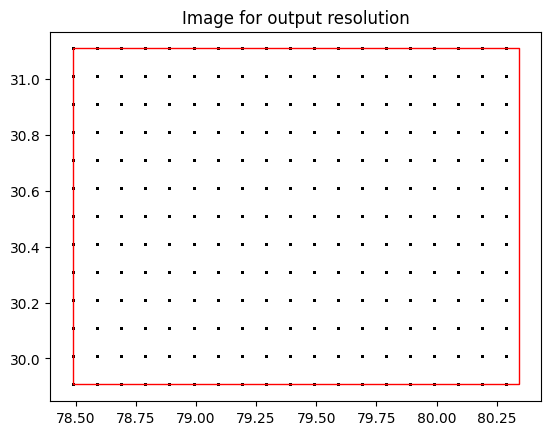

lenghts of x_values,y_values,x_values_output,y_values_output:  8 5 19 13


In [20]:
if __name__ == "__main__":
    xc_inp,yc_inp,xc_out,yc_out,grids=res_change(minx, miny, maxx, maxy, input_res=0.25, output_res=0.1)

In [21]:
grid=[]
for cell in grids:
    polygon = Polygon(list(zip(cell['X'], cell['Y'])))
    grid.append(polygon)

grid_gdf = gpd.GeoDataFrame({'geometry': grid}, crs=shape_file.crs)

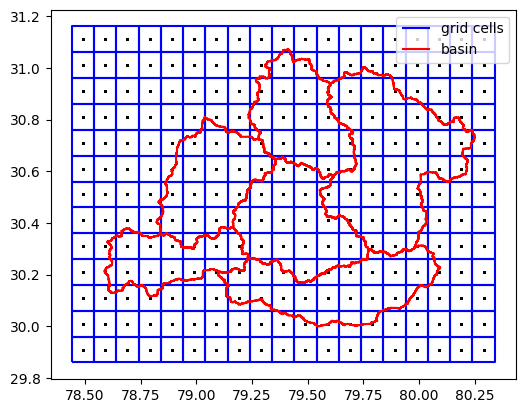

In [22]:
fig, ax = plt.subplots()
ax.scatter(xc_out, yc_out, s=1, color='black')
grid_gdf.boundary.plot(ax=ax, color='blue', label='grid cells')
shape_file.boundary.plot(ax=ax, color='red',label='basin')
plt.legend()
plt.show()

## Loading the data and performing the interpolation at the desired resolution.

In [23]:
#importing the required libraries
import xarray as xr
import scipy.interpolate as sci
import tqdm

In [24]:
ds = xr.open_dataset(r'C:\Users\Ankit\Documents\Vedanshi\nc_merged\study_region.nc')
df=ds.to_dataframe().reset_index()
df.drop(columns=['nv','lon_bnds','lat_bnds'],inplace=True)
#checking for missing values and see if there exists any pattern in the missing values.
df[df.isna().any(axis=1)].tail()
df

,time,lon,lat,precipitation
0,1983-01-01,78.625,30.875,0.000000
1,1983-01-01,78.625,30.625,0.000000
2,1983-01-01,78.625,30.375,0.000000
3,1983-01-01,78.625,30.125,0.000000
4,1983-01-01,78.625,30.875,0.000000
...,...,...,...,...
838595,2023-12-31,80.125,30.125,0.682039
838596,2023-12-31,80.125,30.875,0.000000
838597,2023-12-31,80.125,30.625,0.241781
838598,2023-12-31,80.125,30.375,0.117583


In [25]:
ds

<xarray.Dataset> Size: 3MB
Dimensions:        (time: 14975, lon: 7, nv: 2, lat: 4)
Coordinates:
  * time           (time) datetime64[ns] 120kB 1983-01-01 ... 2023-12-31
  * lat            (lat) float32 16B 30.88 30.62 30.38 30.12
  * lon            (lon) float32 28B 78.62 78.88 79.12 79.38 79.62 79.88 80.12
Dimensions without coordinates: nv
Data variables:
    lon_bnds       (time, lon, nv) float32 839kB 78.5 78.75 78.75 ... 80.0 80.25
    lat_bnds       (time, lat, nv) float32 479kB 31.0 30.75 30.75 ... 30.25 30.0
    precipitation  (time, lon, lat) float32 2MB 0.0 0.0 0.0 ... 0.1176 0.682
Attributes: (12/37)
    datetime:                   1983-01-01
    Conventions:                CF-1.6
    title:                      NOAA Climate Data Record (CDR) of Precipitati...
    comment:                    Daily PERSIANN-CDR precipitation estimates fo...
    source:                     GRIDSAT-B1.1983.01.01.00.v02r01.nc,GRIDSAT-B1...
    Metadata_Conventions:       CF-1.6,Unidata Dataset Discovery v1.0, NOAA C...
    ...                         ...
    contributor_role:           PrincipalInvestigator, Professor, Author, Author
    cdr_program:                NOAA Climate Data Record Program
    cdr_variable:               precipitation
    metadata_link:              gov.noaa.ncdc:C00854
    product_version:            v01r01
    spatial_resolution:         0.25 degrees

In [26]:
df.drop_duplicates(inplace=True,ignore_index=True)
df

,time,lon,lat,precipitation
0,1983-01-01,78.625,30.875,0.000000
1,1983-01-01,78.625,30.625,0.000000
2,1983-01-01,78.625,30.375,0.000000
3,1983-01-01,78.625,30.125,0.000000
4,1983-01-01,78.875,30.875,0.000000
...,...,...,...,...
419295,2023-12-31,79.875,30.125,0.590442
419296,2023-12-31,80.125,30.875,0.000000
419297,2023-12-31,80.125,30.625,0.241781
419298,2023-12-31,80.125,30.375,0.117583


In [27]:
#handleing the nan values, cannot determine any definite pattern so filling the nan values with 0.
df['precipitation'] = df['precipitation'].fillna(0)
df.isna().sum()

time             0
lon              0
lat              0
precipitation    0
dtype: int64

In [28]:
#seeing the dims of 0.1 resolution grid
print("dims of grid= ",(((yc_out[len(yc_out)-1][0] - yc_out[0][0]) // 0.1,(xc_out[0][len(xc_out[0])-1] - xc_out[0][0]) // 0.1)))

dims of grid=  (np.float64(11.0), np.float64(18.0))


In [29]:
#seein the dims of 0.25 resolution grid
print("dims of grid= ",(((yc_inp[len(yc_inp)-1][0] - yc_inp[0][0]) // 0.25,(xc_inp[0][len(xc_inp[0])-1] - xc_inp[0][0]) // 0.25)))

dims of grid=  (np.float64(4.0), np.float64(7.0))


In [30]:
xc_inp,yc_inp

(array([[78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24],
        [78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24],
        [78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24],
        ...,
        [78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24],
        [78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24],
        [78.49, 78.49, 78.49, ..., 80.24, 80.24, 80.24]]),
 array([[29.91, 29.91, 29.91, ..., 29.91, 29.91, 29.91],
        [30.16, 30.16, 30.16, ..., 30.16, 30.16, 30.16],
        [30.41, 30.41, 30.41, ..., 30.41, 30.41, 30.41],
        ...,
        [30.41, 30.41, 30.41, ..., 30.41, 30.41, 30.41],
        [30.66, 30.66, 30.66, ..., 30.66, 30.66, 30.66],
        [30.91, 30.91, 30.91, ..., 30.91, 30.91, 30.91]]))

In [31]:
df.iloc[0:28]

,time,lon,lat,precipitation
0,1983-01-01,78.625,30.875,0.000000
1,1983-01-01,78.625,30.625,0.000000
2,1983-01-01,78.625,30.375,0.000000
3,1983-01-01,78.625,30.125,0.000000
4,1983-01-01,78.875,30.875,0.000000
5,1983-01-01,78.875,30.625,0.000000
6,1983-01-01,78.875,30.375,0.000000
7,1983-01-01,78.875,30.125,0.000000
8,1983-01-01,79.125,30.875,0.000000
9,1983-01-01,79.125,30.625,0.000000


In [32]:
#extracting the data.
first_day=df.iloc[0:28]
lat=first_day['lat'].values
lon=first_day['lon'].values
prcp_points = np.column_stack((lon.ravel(), lat.ravel()))
prcp=np.array(first_day['precipitation']) #values for 1st day.
print(prcp)
print('\n',len(prcp_points)==len(prcp))
prcp_points

[0.        0.        0.        0.        0.        0.        0.
 0.        0.        0.        0.        0.        0.        0.
 0.        0.        1.6956418 0.        0.        0.        0.
 0.        0.        0.        0.        0.8967991 0.        0.       ]

 True


array([[78.625, 30.875],
       [78.625, 30.625],
       [78.625, 30.375],
       [78.625, 30.125],
       [78.875, 30.875],
       [78.875, 30.625],
       [78.875, 30.375],
       [78.875, 30.125],
       [79.125, 30.875],
       [79.125, 30.625],
       [79.125, 30.375],
       [79.125, 30.125],
       [79.375, 30.875],
       [79.375, 30.625],
       [79.375, 30.375],
       [79.375, 30.125],
       [79.625, 30.875],
       [79.625, 30.625],
       [79.625, 30.375],
       [79.625, 30.125],
       [79.875, 30.875],
       [79.875, 30.625],
       [79.875, 30.375],
       [79.875, 30.125],
       [80.125, 30.875],
       [80.125, 30.625],
       [80.125, 30.375],
       [80.125, 30.125]], dtype=float32)

NearestNDInterpolator - nearest neighobour interpolator. 

LinearNDInterpolator - performs pairwise interpolation. 

cubic - does bilinear interpolation.

In [33]:
lon=list(np.unique(xc_out[0]))
lat=[]
for i in yc_out:
    lat.append(i[0])
lat==np.array(lat)
lat=list(np.unique(lat))
lat
lon

[np.float64(78.49),
 np.float64(78.59),
 np.float64(78.69),
 np.float64(78.79),
 np.float64(78.89),
 np.float64(78.99),
 np.float64(79.09),
 np.float64(79.19),
 np.float64(79.29),
 np.float64(79.39),
 np.float64(79.49),
 np.float64(79.59),
 np.float64(79.69),
 np.float64(79.79),
 np.float64(79.89),
 np.float64(79.99),
 np.float64(80.09),
 np.float64(80.19),
 np.float64(80.29)]

In [34]:
#these are the centroids of the grid cells for the output resolution grid.
inter_lat,inter_lon=np.meshgrid(lat,lon)
inter_points=np.column_stack((inter_lon.ravel(),inter_lat.ravel()))
inter_points=pd.DataFrame(inter_points,columns=['lon','lat'])
inter_points.drop_duplicates(inplace=True)	
inter_points

,lon,lat
0,78.49,29.91
1,78.49,30.01
2,78.49,30.11
3,78.49,30.21
4,78.49,30.31
...,...,...
242,80.29,30.71
243,80.29,30.81
244,80.29,30.91
245,80.29,31.01


In [35]:
def interpolate(initial_res_points,data,coords,method_used):
    coords = np.array(coords)
    if coords.ndim == 1:
        coords = coords[np.newaxis, :]
    if method_used=='linear' or method_used=='nearest':
        if method_used=='nearest':
            return sci.griddata(initial_res_points,data,coords,method='nearest') #nearest neighbour
        else:
            return sci.griddata(initial_res_points,data,coords,method='linear') #linear.
    else :
            return sci.griddata(initial_res_points,data,coords,method='cubic') #splines.

In [36]:
prcp_points

array([[78.625, 30.875],
       [78.625, 30.625],
       [78.625, 30.375],
       [78.625, 30.125],
       [78.875, 30.875],
       [78.875, 30.625],
       [78.875, 30.375],
       [78.875, 30.125],
       [79.125, 30.875],
       [79.125, 30.625],
       [79.125, 30.375],
       [79.125, 30.125],
       [79.375, 30.875],
       [79.375, 30.625],
       [79.375, 30.375],
       [79.375, 30.125],
       [79.625, 30.875],
       [79.625, 30.625],
       [79.625, 30.375],
       [79.625, 30.125],
       [79.875, 30.875],
       [79.875, 30.625],
       [79.875, 30.375],
       [79.875, 30.125],
       [80.125, 30.875],
       [80.125, 30.625],
       [80.125, 30.375],
       [80.125, 30.125]], dtype=float32)

In [37]:
#testing.
a=interpolate(prcp_points, prcp, inter_points, method_used='nearest')
a

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

## Making the data for the rest of the 40 years

In [38]:
df[28:56]

,time,lon,lat,precipitation
28,1983-01-02,78.625,30.875,0.000000
29,1983-01-02,78.625,30.625,0.000000
30,1983-01-02,78.625,30.375,0.000000
31,1983-01-02,78.625,30.125,0.000000
32,1983-01-02,78.875,30.875,0.000000
33,1983-01-02,78.875,30.625,0.000000
34,1983-01-02,78.875,30.375,0.000000
35,1983-01-02,78.875,30.125,0.000000
36,1983-01-02,79.125,30.875,0.000000
37,1983-01-02,79.125,30.625,0.000000


In [39]:
df

,time,lon,lat,precipitation
0,1983-01-01,78.625,30.875,0.000000
1,1983-01-01,78.625,30.625,0.000000
2,1983-01-01,78.625,30.375,0.000000
3,1983-01-01,78.625,30.125,0.000000
4,1983-01-01,78.875,30.875,0.000000
...,...,...,...,...
419295,2023-12-31,79.875,30.125,0.590442
419296,2023-12-31,80.125,30.875,0.000000
419297,2023-12-31,80.125,30.625,0.241781
419298,2023-12-31,80.125,30.375,0.117583


In [40]:
ds

<xarray.Dataset> Size: 3MB
Dimensions:        (time: 14975, lon: 7, nv: 2, lat: 4)
Coordinates:
  * time           (time) datetime64[ns] 120kB 1983-01-01 ... 2023-12-31
  * lat            (lat) float32 16B 30.88 30.62 30.38 30.12
  * lon            (lon) float32 28B 78.62 78.88 79.12 79.38 79.62 79.88 80.12
Dimensions without coordinates: nv
Data variables:
    lon_bnds       (time, lon, nv) float32 839kB 78.5 78.75 78.75 ... 80.0 80.25
    lat_bnds       (time, lat, nv) float32 479kB 31.0 30.75 30.75 ... 30.25 30.0
    precipitation  (time, lon, lat) float32 2MB 0.0 0.0 0.0 ... 0.1176 0.682
Attributes: (12/37)
    datetime:                   1983-01-01
    Conventions:                CF-1.6
    title:                      NOAA Climate Data Record (CDR) of Precipitati...
    comment:                    Daily PERSIANN-CDR precipitation estimates fo...
    source:                     GRIDSAT-B1.1983.01.01.00.v02r01.nc,GRIDSAT-B1...
    Metadata_Conventions:       CF-1.6,Unidata Dataset Discovery v1.0, NOAA C...
    ...                         ...
    contributor_role:           PrincipalInvestigator, Professor, Author, Author
    cdr_program:                NOAA Climate Data Record Program
    cdr_variable:               precipitation
    metadata_link:              gov.noaa.ncdc:C00854
    product_version:            v01r01
    spatial_resolution:         0.25 degrees

start_date = '1984-01-01'
end_date = '2023-12-31'
date_range = pd.date_range(start=start_date, end=end_date, freq='D')
dates_df = pd.DataFrame({'date': date_range})
dates_df
lat_lon_df = pd.DataFrame({'lat': xc_out.flatten(), 'lon': yc_out.flatten()})
dates_df['key'] = 1
lat_lon_df['key'] = 1
df_10= pd.merge(dates_df, lat_lon_df, on='key').drop('key', axis=1)
df_10

In [41]:
start_date = '1983-01-01'
end_date = '2023-12-31'
date_range = pd.date_range(start=start_date, end=end_date, freq='D')
data = xr.DataArray(
    np.zeros((len(date_range), len(lon), len(lat))), 
    coords={'time': date_range,  'lon': lon,'lat': lat},
    dims=['time', 'lon', 'lat']
)
#CONVERTING THE DATA TO DATAFRAME FOR EASY MANIPULATION.
df_10=data.to_dataframe(name='data').reset_index()
df_10

,time,lon,lat,data
0,1983-01-01,78.49,29.91,0.0
1,1983-01-01,78.49,30.01,0.0
2,1983-01-01,78.49,30.11,0.0
3,1983-01-01,78.49,30.21,0.0
4,1983-01-01,78.49,30.31,0.0
...,...,...,...,...
3698820,2023-12-31,80.29,30.71,0.0
3698821,2023-12-31,80.29,30.81,0.0
3698822,2023-12-31,80.29,30.91,0.0
3698823,2023-12-31,80.29,31.01,0.0


In [42]:
df_10.iloc[0:247]

,time,lon,lat,data
0,1983-01-01,78.49,29.91,0.0
1,1983-01-01,78.49,30.01,0.0
2,1983-01-01,78.49,30.11,0.0
3,1983-01-01,78.49,30.21,0.0
4,1983-01-01,78.49,30.31,0.0
...,...,...,...,...
242,1983-01-01,80.29,30.71,0.0
243,1983-01-01,80.29,30.81,0.0
244,1983-01-01,80.29,30.91,0.0
245,1983-01-01,80.29,31.01,0.0


In [43]:
df_10.drop_duplicates(inplace=True,ignore_index=True)
df_10

,time,lon,lat,data
0,1983-01-01,78.49,29.91,0.0
1,1983-01-01,78.49,30.01,0.0
2,1983-01-01,78.49,30.11,0.0
3,1983-01-01,78.49,30.21,0.0
4,1983-01-01,78.49,30.31,0.0
...,...,...,...,...
3698820,2023-12-31,80.29,30.71,0.0
3698821,2023-12-31,80.29,30.81,0.0
3698822,2023-12-31,80.29,30.91,0.0
3698823,2023-12-31,80.29,31.01,0.0


In [44]:
ds

<xarray.Dataset> Size: 3MB
Dimensions:        (time: 14975, lon: 7, nv: 2, lat: 4)
Coordinates:
  * time           (time) datetime64[ns] 120kB 1983-01-01 ... 2023-12-31
  * lat            (lat) float32 16B 30.88 30.62 30.38 30.12
  * lon            (lon) float32 28B 78.62 78.88 79.12 79.38 79.62 79.88 80.12
Dimensions without coordinates: nv
Data variables:
    lon_bnds       (time, lon, nv) float32 839kB 78.5 78.75 78.75 ... 80.0 80.25
    lat_bnds       (time, lat, nv) float32 479kB 31.0 30.75 30.75 ... 30.25 30.0
    precipitation  (time, lon, lat) float32 2MB 0.0 0.0 0.0 ... 0.1176 0.682
Attributes: (12/37)
    datetime:                   1983-01-01
    Conventions:                CF-1.6
    title:                      NOAA Climate Data Record (CDR) of Precipitati...
    comment:                    Daily PERSIANN-CDR precipitation estimates fo...
    source:                     GRIDSAT-B1.1983.01.01.00.v02r01.nc,GRIDSAT-B1...
    Metadata_Conventions:       CF-1.6,Unidata Dataset Discovery v1.0, NOAA C...
    ...                         ...
    contributor_role:           PrincipalInvestigator, Professor, Author, Author
    cdr_program:                NOAA Climate Data Record Program
    cdr_variable:               precipitation
    metadata_link:              gov.noaa.ncdc:C00854
    product_version:            v01r01
    spatial_resolution:         0.25 degrees

In [45]:
df_10.iloc[0:247]

,time,lon,lat,data
0,1983-01-01,78.49,29.91,0.0
1,1983-01-01,78.49,30.01,0.0
2,1983-01-01,78.49,30.11,0.0
3,1983-01-01,78.49,30.21,0.0
4,1983-01-01,78.49,30.31,0.0
...,...,...,...,...
242,1983-01-01,80.29,30.71,0.0
243,1983-01-01,80.29,30.81,0.0
244,1983-01-01,80.29,30.91,0.0
245,1983-01-01,80.29,31.01,0.0


In [46]:
data

<xarray.DataArray (time: 14975, lon: 19, lat: 13)> Size: 30MB
array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
...
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]])
Coordinates:
  * time     (time) datetime64[ns] 120kB 1983-01-01 1983-01-02 ... 2023-12-31
  * lon      (lon) float64 152B 78.49 78.59 78.69 78.79 ... 80.09 80.19 80.29
  * lat      (lat) float64 104B 29.91 30.01 30.11 30.21 ... 30.91 31.01 31.11

In [47]:
df

,time,lon,lat,precipitation
0,1983-01-01,78.625,30.875,0.000000
1,1983-01-01,78.625,30.625,0.000000
2,1983-01-01,78.625,30.375,0.000000
3,1983-01-01,78.625,30.125,0.000000
4,1983-01-01,78.875,30.875,0.000000
...,...,...,...,...
419295,2023-12-31,79.875,30.125,0.590442
419296,2023-12-31,80.125,30.875,0.000000
419297,2023-12-31,80.125,30.625,0.241781
419298,2023-12-31,80.125,30.375,0.117583


In [48]:
for i in tqdm.tqdm(range(14975), desc='running the loop for 40 years', ascii=True):
   prcp=np.array(df.iloc[i*28:(i+1)*28]['precipitation'])
   interpolated_data = interpolate(prcp_points, prcp, inter_points, method_used='nearest')
   df_10['data'][i*247:(i+1)*247] = interpolated_data
df_10

running the loop for 40 years:   0%|          | 0/14975 [00:00<?, ?it/s]C:\Users\Ankit\AppData\Local\Temp\ipykernel_7140\4257793798.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_10['data'][i*247:(i+1)*247] = interpolated_data
C:\Use

,time,lon,lat,data
0,1983-01-01,78.49,29.91,0.000000
1,1983-01-01,78.49,30.01,0.000000
2,1983-01-01,78.49,30.11,0.000000
3,1983-01-01,78.49,30.21,0.000000
4,1983-01-01,78.49,30.31,0.000000
...,...,...,...,...
3698820,2023-12-31,80.29,30.71,0.241781
3698821,2023-12-31,80.29,30.81,0.000000
3698822,2023-12-31,80.29,30.91,0.000000
3698823,2023-12-31,80.29,31.01,0.000000
